<a href="https://colab.research.google.com/github/riccardomarin/Tutorial_Spectral_Geometry/blob/main/SGP23.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!wget https://raw.githubusercontent.com/riccardomarin/EG22_Tutorial_Spectral_Geometry/main/data/tr_reg_090.off
!wget https://raw.githubusercontent.com/riccardomarin/EG22_Tutorial_Spectral_Geometry/main/data/tr_reg_043.off
!wget https://raw.githubusercontent.com/riccardomarin/EG22_Tutorial_Spectral_Geometry/main/utils/utils_mesh.py
!wget https://raw.githubusercontent.com/riccardomarin/EG22_Tutorial_Spectral_Geometry/main/utils/utils_spectral.py
!pip install plyfile

import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
import scipy.io as sio
import scipy.sparse.linalg
from scipy.sparse.linalg import eigsh
from scipy.sparse import csr_matrix

import numpy as np
import pandas as pd
import torch
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from torch import nn
from torch.autograd import Variable

from utils_spectral import LB_FEM_sparse, EigendecompositionSparse, LB_cotan, Eigendecomposition
from utils_mesh import load_off
from utils_mesh import plot_colormap, plot_RGBmap


--2023-06-30 14:07:28--  https://raw.githubusercontent.com/riccardomarin/EG22_Tutorial_Spectral_Geometry/main/data/tr_reg_090.off
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 506161 (494K) [text/plain]
Saving to: ‘tr_reg_090.off’

tr_reg_090.off      100%[===================>] 494.30K  --.-KB/s    in 0.01s   

2023-06-30 14:07:28 (49.2 MB/s) - ‘tr_reg_090.off’ saved [506161/506161]

--2023-06-30 14:07:28--  https://raw.githubusercontent.com/riccardomarin/EG22_Tutorial_Spectral_Geometry/main/data/tr_reg_043.off
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, await

# PRELIMINARY


Loading the shapes

In [2]:
with open("tr_reg_090.off") as f:
  v_src, f_src = load_off(f)
  f_src = np.asarray(f_src).astype('long')

with open("tr_reg_043.off") as f:
  v_tar, f_tar = load_off(f)
  f_tar = np.asarray(f_tar).astype('long')

p = plot_colormap([v_src,v_tar], [f_src, f_tar],[np.ones(v_src.shape[0])]*2)
p.show()

These shapes share the same triangulation; thus they enjoy a natural GT correspondence.

In [3]:
# This is a common function obtained from 3D coordinates, used to visualize the
# quality of the correspondence

funz_ = (v_src - np.min(v_src,0))/np.tile((np.max(v_src,0)-np.min(v_src,0)),(np.size(v_src,0),1));
colors = np.cos(funz_);
funz_tar = (colors-np.min(colors))/(np.max(colors) - np.min(colors));

# Given that the two shapes have vertices sorted in the same way, the GT correspondence
# is the identity
p = plot_RGBmap([v_src, v_tar], [f_src,f_tar],[funz_tar,funz_tar])
p.show()

# BASIS

In [4]:
dtype = 'float32'
k = 100

# === COMPUING LBO EIGENFUNCTIONS ===
v_src_t = torch.from_numpy(v_src.astype(dtype)).cuda()*1
f_src_t = torch.from_numpy(np.asarray(f_src).astype('long')).cuda()

L_sym_sp, A_sp_src, Ainv_sp = LB_FEM_sparse(v_src_t, f_src_t.long())
evecs_src, evals_src = EigendecompositionSparse(L_sym_sp.values(),L_sym_sp.indices(), torch.tensor(k), torch.tensor(L_sym_sp.shape[-1]))
evecs_src = evecs_src * Ainv_sp[:,None]

v_tar_t = torch.from_numpy(v_tar.astype(dtype)).cuda()*1
f_tar_t = torch.from_numpy(np.asarray(f_tar).astype('long')).cuda()

L_sym_sp, A_sp_tar, Ainv_sp = LB_FEM_sparse(v_tar_t, f_tar_t.long())
evecs_tar, evals_tar = EigendecompositionSparse(L_sym_sp.values(),L_sym_sp.indices(), torch.tensor(k), torch.tensor(L_sym_sp.shape[-1]))
evecs_tar = evecs_tar * Ainv_sp[:,None]

# === SAVING IN NUMPY ===
evecs_tar = evecs_tar.detach().cpu().numpy()
evals_tar = evals_tar.detach().cpu().numpy()

evecs_src = evecs_src.detach().cpu().numpy()
evals_src = evals_src.detach().cpu().numpy()

# === VISUALIZING THEM ===
p_src = plot_colormap([v_src,v_src,v_src], [f_src, f_src, f_src],[evecs_src[:,1],evecs_src[:,2],evecs_src[:,3]])
p_tar = plot_colormap([v_tar,v_tar,v_tar], [f_tar, f_tar, f_tar],[evecs_tar[:,1],evecs_tar[:,2],evecs_tar[:,3]])
p_src.show()
p_tar.show()

Shape representations:

In [5]:
# Low
k = 4
evecs_trim = evecs_src[:,0:k]
v = evecs_trim @ (evecs_trim.T * A_sp_src[None,:].detach().cpu().numpy()) @ v_src_t.detach().cpu().numpy()

p = plot_colormap([v]*3, [f_src_t.long()]*3,[np.ones(v.shape[0])] )
p.show()

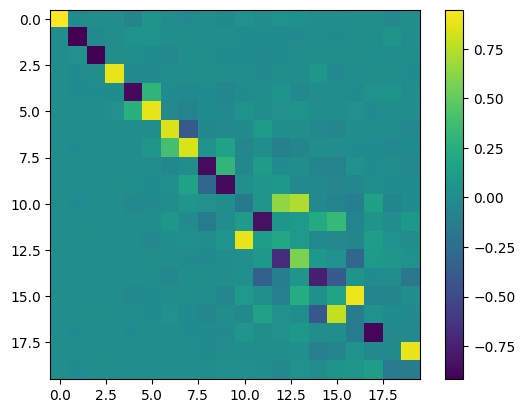

In [19]:
C_gt = (evecs_tar.T * np.asarray(A_sp_tar.cpu())) @ evecs_src
plt.imshow(C_gt[:20,:20])
plt.colorbar()
plt.show()

Basis recombination

In [46]:
evecs_src[:,10:11]

evecs_tar[:,[10,11,12,13]]


p1 = plot_colormap([v_tar]*1, [f_src_t.long()]*1,[evecs_tar[:,10:11]])
p1.show()

p2 = plot_colormap([v_src]*4, [f_src_t.long()]*4,[evecs_src[:,10],evecs_src[:,12],evecs_src[:,13],evecs_src[:,14] ])
p2.show()


In [74]:
E_transf =  evecs_src[:,:20]@ C_gt[:20,:20].T

In [75]:
p3 = plot_colormap([v_src]*1, [f_src_t.long()]*1,[E_transf[:,10] ])
p3.show()

DESCRIPTORS

In [8]:
# compute the WKS descriptor
def WKS(vertices, faces, evals, evecs, wks_size, variance):
    # Number of vertices
    n = vertices.shape[0]
    WKS = np.zeros((n,wks_size))

    # Just for numerical stability
    evals[evals<1e-6] = 1e-6

    # log(E)
    log_E = np.log(evals).T

    # Defining the energies step
    e = np.linspace(log_E[1], np.max(log_E)/1.02, wks_size)

    # Computing the sigma
    sigma = (e[1]-e[0]) * variance
    C = np.zeros((wks_size,1))

    for i in np.arange(0,wks_size):
        # Computing WKS
        WKS[:,i] = np.sum(
            (evecs)**2 * np.tile( np.exp((-(e[i] - log_E)**2) / (2*sigma**2)),(n,1)), axis=1)

        # Normalization
        C[i] = np.sum(np.exp((-(e[i]-log_E)**2)/(2*sigma**2)))

    WKS = np.divide(WKS,np.tile(C,(1,n)).T)
    return WKS

def HKS(vertices, faces, evals, evecs, hks_size):
    # Number of vertices
    n = vertices.shape[0]
    hks = np.zeros((n,hks_size))

    # Just for numerical stability
    evals[evals<1e-6] = 1e-6

    # hks_size samples logarithmically scaled
    t_min = 4*np.log(10)/evals[-1]
    t_max = 4*np.log(10)/evals[2]
    t = np.logspace(np.log10(t_min), np.log10(t_max) , num=hks_size)

    for i in np.arange(0,hks_size):
        # Computing hks
        # print(t[i])
        hks[:,i] = np.sum( np.exp(-(evals.T * t[i])) * (evecs)**2 , axis=1)
        # print((np.exp(-(evals.T * t[i])) * (evecs)**2).shape)

    return hks,t

In [10]:
d_src, t_src = HKS(v_src, f_src, evals_src, evecs_src, 100)
d_tar = HKS(v_tar, f_tar, evals_tar, evecs_tar, 100)
d_tar = d_tar

print(d_src.shape)

(6890, 100)


Baseline: we can compute a matching directly in the descriptor space.

In [11]:
import scipy as sp

# Computing the descriptors for the two shapes
d_src = WKS(v_src, f_src, evals_src, evecs_src, 100, 7)
d_tar = WKS(v_tar, f_tar, evals_tar, evecs_tar, 100, 7)

# Nearest Neighbor to obtain the p2p map
treesearch = sp.spatial.cKDTree(d_src)
p2p = treesearch.query(d_tar, k=1)[1]

# To see the quality of the matching we plot a function on one shape and we transfer it to the other
funz_ = (v_src - np.min(v_src,0))/np.tile((np.max(v_src,0)-np.min(v_src,0)),(np.size(v_src,0),1));
colors = np.cos(funz_);
funz_src = (colors-np.min(colors))/(np.max(colors) - np.min(colors));

p = plot_RGBmap([v_src, v_tar], [f_src,f_tar],[funz_src,funz_src[p2p,:]])
p.show()

# Computing (euclidean) error evaluation
err = np.sum(np.square(v_tar - v_tar[p2p,:]))
print(err)

306.7226106083646


# FMAP Optimization

In [13]:
# Recovering useful variables
evecs_tar = evecs_tar
evals_tar = evals_tar
evecs_src = evecs_src
evals_src = evals_src
A_src = np.diag(A_sp_src.cpu().detach().numpy())
A_tar = np.diag(A_sp_tar.cpu().detach().numpy())

# Computing descriptors
n_land =  6

n_descs  =  100
n_evals = 20

# Landmarks, as step functions randomly sampled
step = np.int(np.ceil(v_src.shape[0] / n_land))
a = np.arange(0,v_src.shape[0],step)
landmarks = np.zeros((v_src.shape[0], a.size))
landmarks[a,np.arange(a.size)] = 1

# WKS
# d_src = WKS(v_src, f_src, evals_src, evecs_src, n_wks, 7)
# d_tar = WKS(v_tar, f_tar, evals_tar, evecs_tar, n_wks, 7)
d_src, t_src = HKS(v_src, f_src, evals_src, evecs_src, n_descs)
d_tar, t_tar = HKS(v_tar, f_tar, evals_tar, evecs_tar, n_descs)


# Optimization Process
desc_src = np.hstack((landmarks,d_src))
desc_tar = np.hstack((landmarks,d_tar))

# Descriptor normalization
no = np.sqrt(np.diag(np.matmul(A_src.__matmul__(desc_src).T, desc_src)))
no_s = np.tile(no.T,(v_src.shape[0],1))
no_t = np.tile(no.T,(v_tar.shape[0],1))
fct_src = np.divide(desc_src,no_s)
fct_tar = np.divide(desc_tar,no_t)

# Coefficents of the obtained descriptors
Fct_src = np.matmul(A_src.T.__matmul__(evecs_src[:, 0:n_evals]).T, fct_src)
Fct_tar = np.matmul(A_tar.T.__matmul__(evecs_tar[:, 0:n_evals]).T, fct_tar)

# The relation between the two constant functions can be computed in a closed form
constFct = np.zeros((n_evals,1))
constFct[0, 0] = np.sign(evecs_src[0, 0] * evecs_tar[0, 0]) * np.sqrt(np.sum(A_tar)/np.sum(A_src))

# Energy weights
w1 = 1e-1 # Descriptors preservation
w2 = 1e-8 # Commutativity with Laplacian

# Define torch objects
fs = torch.Tensor(Fct_src)
ft = torch.Tensor(Fct_tar)
evals = torch.diag(torch.Tensor(np.reshape(np.float32(evals_src[0:n_evals]), (n_evals,))))
evalt = torch.diag(torch.Tensor(np.reshape(np.float32(evals_tar[0:n_evals]), (n_evals,))))

#### Optimization  #####
import progressbar
C_ini = np.zeros((n_evals,n_evals))
C_ini[0,0]=constFct[0,0]
C = Variable(torch.Tensor(C_ini), requires_grad=True)

optimizer = torch.optim.Adam([C], lr=5e-2)

for it in progressbar.progressbar(range(1500)):
    optimizer.zero_grad()

    # Loss computation
    loss1 = w1 * torch.sum(((torch.matmul(C, fs) - ft) ** 2)) / 2 # Descriptor preservation
    loss2 = w2 * torch.sum((torch.matmul(C, evals) - torch.matmul(evalt,C))**2) # Commute with Laplacian
    loss = torch.sum(loss1  + loss2)

    # Gradient descent
    loss.backward()
    optimizer.step()

<ipython-input-13-c0fb55ef8f6c>:16: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

100% (1500 of 1500) |####################| Elapsed Time: 0:00:01 Time:  0:00:01


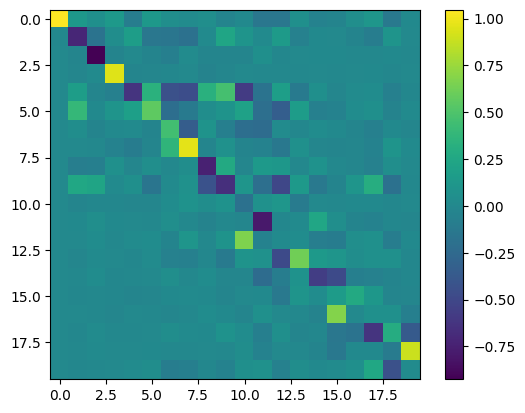

82.28904031596895


In [14]:
# Showing C matrix
C_np = C.detach().numpy()
plt.imshow(C_np)
plt.colorbar()
plt.show()

# Point-to-point correspondence computation
treesearch = sp.spatial.cKDTree(np.matmul(evecs_src[:,0:n_evals], C_np.T))
p2p = treesearch.query(evecs_tar[:,0:n_evals], k=1)[1]

# Correspondence visualization
funz_src = funz_tar

p = plot_RGBmap([v_src, v_tar], [f_src,f_tar],[funz_src,funz_src[p2p,:]])
p.show()

# Computing (euclidean) error evaluation
err = np.sum(np.square(v_tar - v_tar[p2p,:]))
print(err)

VISUALIZING DESCRIPTORS

In [15]:
idx = 80

p_src = plot_colormap([v_src], [f_src],[d_src[:,idx]])
p_tar = plot_colormap([v_tar], [f_tar],[d_tar[:,idx]])

p_src.show()
p_tar.show()

#### Descriptor Transfer

In [16]:
Fct_src = np.matmul(A_src.T.__matmul__(evecs_src[:, 0:n_evals]).T, fct_src)
Fct_tar = np.matmul(A_tar.T.__matmul__(evecs_tar[:, 0:n_evals]).T, fct_tar)

d_tar_src = torch.tensor(evecs_src[:, 0:n_evals]) @ C.detach() @ Fct_tar

In [17]:
p_src = plot_colormap([v_src,v_src,v_src], [f_src, f_src, f_src],[desc_src[:,3],desc_src[:,25],desc_src[:,80]])
p_tar = plot_colormap([v_tar,v_tar,v_tar], [f_tar, f_tar, f_tar],[desc_tar[:,3],desc_tar[:,25],desc_tar[:,80]])
p_tar_src = plot_colormap([v_src,v_src,v_src], [f_src, f_src, f_src],[d_tar_src[:,3],d_tar_src[:,25],d_tar_src[:,80]])
p_src.show()
p_tar.show()
p_tar_src.show()

# ICP REFINEMENT

ICP refine...


<ipython-input-18-6993aa0c45d5>:8: FutureWarning:

`rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



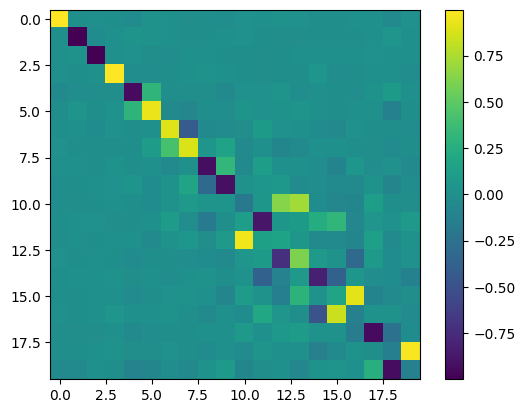

17.156726253248415


In [18]:
print('ICP refine...')
C_ICP = C_np

# ICP Refining
for k in np.arange(0,5):
    treesearch = scipy.spatial.cKDTree(np.matmul(evecs_src[:,0:n_evals],C_ICP.T))
    matches = treesearch.query(evecs_tar[:,0:n_evals], k=1)[1]
    W = np.linalg.lstsq(evecs_tar[matches, 0:n_evals],evecs_src[:, 0:n_evals])[0]
    d = np.linalg.svd(W)
    C_ICP = np.matmul(np.matmul(d[0], np.eye(n_evals)), d[2])

# C Visualization
plt.imshow(C_ICP)
plt.colorbar()
plt.show()

# Correspondence visualization
treesearch = scipy.spatial.cKDTree(np.matmul(evecs_src[:,0:n_evals],C_ICP.T))
p2p_icp = treesearch.query(evecs_tar[:,0:n_evals], k=1)[1]

# Correspondence visualization
funz_ = (v_src - np.min(v_src,0))/np.tile((np.max(v_src,0)-np.min(v_src,0)),(np.size(v_src,0),1));
colors = np.cos(funz_);
funz_src = (colors-np.min(colors))/(np.max(colors) - np.min(colors));

p = plot_RGBmap([v_src, v_tar], [f_src,f_tar],[funz_src,funz_src[p2p_icp,:]])
p.show()

# Computing (euclidean) error evaluation
err = np.sum(np.square(v_tar - v_tar[p2p_icp,:]))
print(err)